In [1]:
import sys
import os

module_path = os.path.abspath(os.path.join('..','..','..'))
if module_path not in sys.path:
    sys.path.append(module_path)

import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_auc_score
from scipy.sparse.linalg import svds
import scipy.io as sio

from src.multilinear_ops.tensorize import tensorize
from src.multilinear_ops.t2m import t2m
from src.multilinear_ops.m2t import m2t
from src.synthetic_data.generate_anomaly import generate_sparse_anomaly

from src.models.orpca.orpca import ORPCA
from src.models.rpca.rpca import ExactRpcaALM
from src.synthetic_data.generate_lr_data import generate_low_rank_data

## Empirical Evaluation of ORPCA
As in the paper "Online Robust PCA via Stochastic Optimization"

### 1. Medium-scale Robust PCA


In [2]:
exp_repeat = 10
seed = 0
rng = np.random.default_rng(seed)
p = 400
n = 1000
rank = 80
rho_s = 0.1
U = rng.normal(0, 1, (p,rank))
V = rng.normal(0, 1, (n,rank))
X = U @ V.T
M = 1000
U_subspace, s, _ = np.linalg.svd(X)
U_subspace = U_subspace[:,:rank]
E, anomaly_flag = generate_sparse_anomaly(X, 'uniform', M, rho_s)
Z = X + E

In [3]:
lda_nuc = 0.001
lda1 = 1/np.sqrt(p)
sgd_param = {'annealing_mode': 'sqrt', 'step_size': 1}
benchmarker = {'X_gt': X, 'E_gt': E, 'U_gt': U_subspace}
orpca_sgd = ORPCA(p, model='soft', lda_nuc=lda_nuc, lda1=lda1, rs_update_tol=1e-6, rs_update_maxit=10000,
              mode='cumulative_avg', optimizer='SGD', L_init='random', rank=rank, optimizer_param=sgd_param,
              verbose=1)
bcd_param = {'annealing_mode': 'constant'} 
orpca_bcd = ORPCA(p, rank=rank, model='soft', lda_nuc=lda_nuc, lda1=lda1, rs_update_tol=1e-6, rs_update_maxit=10000,
              mode='cumulative_avg', optimizer='BCD', optimizer_param=bcd_param, L_init='random',
              verbose=1)

adam_param = {'bcd': False}
orpca_adam = ORPCA(p, rank=rank, model='soft', lda_nuc=lda_nuc, lda1=lda1, rs_update_tol=1e-6, rs_update_maxit=10000,
              mode='cumulative_avg', optimizer='Adam', optimizer_param=adam_param, L_init='random',
              verbose=1)

adam_param = {'bcd': True}
orpca_adam_bcd = ORPCA(p, rank=rank, model='soft', lda_nuc=lda_nuc, lda1=lda1, rs_update_tol=1e-6, rs_update_maxit=10000,
              mode='cumulative_avg', optimizer='Adam', optimizer_param=adam_param, L_init='random',
              verbose=1)

In [4]:
# X_sgd, R_sgd, E_sgd =  orpca_sgd.run_sequence(Z, benchmark=True, **benchmarker)
# X_bcd, R_bcd, E_bcd =  orpca_bcd.run_sequence(Z, benchmark=True, **benchmarker)
X_adam, R_adam, E_adam =  orpca_adam.run_sequence(Z, benchmark=True, **benchmarker)
# X_adam_bcd, R_adam_bcd, E_adam_bcd =  orpca_adam_bcd.run_sequence(Z, benchmark=True, **benchmarker)

t:1	 min_[r,e] >> loss:9212088.152565317	 it: 4036 	 time:0.4717 	 Converged?:True
t:1	 L_upd >> L_change:0.00100	 time:0.0020
Sample 1/1000	 EV:1.0000	 RecErr:0.0000	 SpErr:0.0000
t:2	 min_[r,e] >> loss:8593663.769628001	 it: 4395 	 time:0.3361 	 Converged?:True
t:2	 L_upd >> L_change:0.00061	 time:0.0020
Sample 2/1000	 EV:1.0000	 RecErr:0.0000	 SpErr:0.0000
t:3	 min_[r,e] >> loss:5127902.956681282	 it: 3106 	 time:0.2487 	 Converged?:True
t:3	 L_upd >> L_change:0.00052	 time:0.0074
Sample 3/1000	 EV:1.0000	 RecErr:0.0000	 SpErr:0.0000
t:4	 min_[r,e] >> loss:4987349.909729324	 it: 2810 	 time:0.2297 	 Converged?:True
t:4	 L_upd >> L_change:0.00040	 time:0.0044
Sample 4/1000	 EV:1.0000	 RecErr:0.0000	 SpErr:0.0000
t:5	 min_[r,e] >> loss:6814956.8407376595	 it: 3317 	 time:0.2517 	 Converged?:True
t:5	 L_upd >> L_change:0.00031	 time:0.0010
Sample 5/1000	 EV:1.0000	 RecErr:0.0000	 SpErr:0.0000
t:6	 min_[r,e] >> loss:6785227.41834789	 it: 3355 	 time:0.2679 	 Converged?:True
t:6	 L_upd >

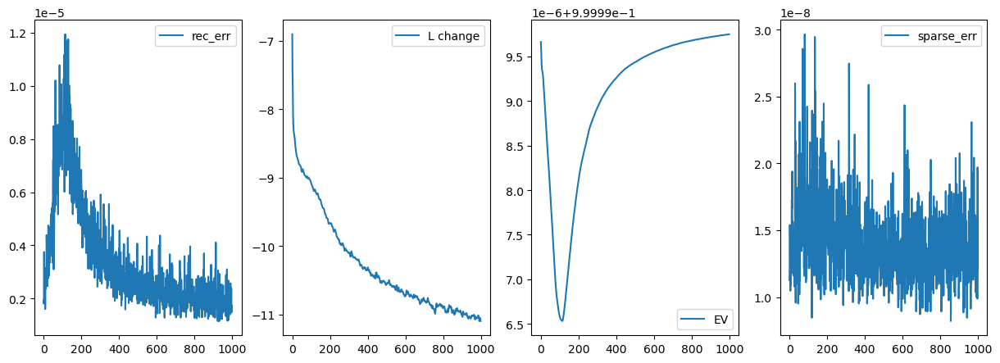

In [6]:
fig,axes = plt.subplots(1,4, figsize=(15,5))
axes[0].plot(orpca_adam.reconstruction_error, label='rec_err')
axes[1].plot(np.log(orpca_adam.L_change), label='L change')
axes[2].plot(orpca_adam.expressed_variance, label='EV')
axes[3].plot(orpca_adam.sparse_error, label='sparse_err')
axes[1].legend()
axes[2].legend()
axes[3].legend()
axes[0].legend()

In [3]:
cwd = os.getcwd()
video_path = os.path.join(cwd, '..', '..', '..', 'data', 'bgfg_video')
video_name = 'pedestrians.mat' #'PETS2006.mat' # 'fountain01.mat' # , badminton
video = sio.loadmat(os.path.join(video_path,video_name))
video.keys()
tstart = 0
tend = 1000
length = tend-tstart
height = video['video'][0][0][1][0,0]
width = video['video'][0][0][1][0,1]
n = (height, width,length)
vid = np.array(video['video'][0][0][3][:,:,tstart:tend], dtype=float)
labels = video['video'][0][0][4][:,:,tstart:tend]
labels[labels<85] = 0
labels[labels>0] = 1
Y = t2m(vid,3).T

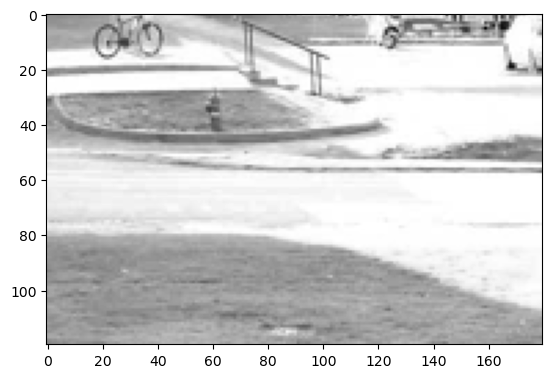

In [7]:
from matplotlib import pyplot as plt
from matplotlib import animation
from IPython.display import display, HTML
def plot_images2(images):
    def init():
        img.set_data(images[:,:,0])
        return (img,)

    def animate(i):
        img.set_data(images[:,:,i])
        return (img,)

    fig = plt.figure()
    ax = fig.gca()
    img = ax.imshow(images[:,:,0], cmap='gray');
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                 frames=images.shape[2], interval=1000/24, blit=True)
    return anim
plt.rcParams["animation.html"] = "jshtml"
HTML(plot_images2(vid[:,:,:100]).to_jshtml())

In [9]:
lda_nuc = 0.1
lda1 = 0.01#1/np.sqrt(Y.shape[0])
adam_param = {'bcd': False}
orpca_adam = ORPCA(Y.shape[0], model='soft', lda_nuc=lda_nuc, lda1=lda1, rs_update_tol=1e-4, rs_update_maxit=10000,
              mode='cumulative_avg', optimizer='Adam', optimizer_param=adam_param, 
              L_init='PCP', burnin_samples=Y[:,:100], verbose=1)
print(f"Rank={orpca_adam.rank}")
X, R, E = orpca_adam.run_sequence(Y[:,100:500])

It-2: 	## 0.10 sec. 	 obj=319629.40874 	## del_obj = 1214.87798
|r|=1636.27972 	 ## |s|=0.25324 	 ## rho=0.00117
It-3: 	## 0.11 sec. 	 obj=320816.94519 	## del_obj = 1187.53646
|r|=1474.09217 	 ## |s|=0.57967 	 ## rho=0.00117
It-4: 	## 0.11 sec. 	 obj=322996.11291 	## del_obj = 2179.16771
|r|=1243.59512 	 ## |s|=0.71038 	 ## rho=0.00117
It-5: 	## 0.15 sec. 	 obj=325258.40748 	## del_obj = 2262.29457
|r|=1040.82675 	 ## |s|=0.64829 	 ## rho=0.00117
It-6: 	## 0.12 sec. 	 obj=327274.51805 	## del_obj = 2016.11057
|r|=871.21160 	 ## |s|=0.52911 	 ## rho=0.00117
It-7: 	## 0.13 sec. 	 obj=329090.92844 	## del_obj = 1816.41039
|r|=710.66700 	 ## |s|=0.44051 	 ## rho=0.00117
It-8: 	## 0.15 sec. 	 obj=330473.11994 	## del_obj = 1382.19149
|r|=580.62184 	 ## |s|=0.31703 	 ## rho=0.00117
It-9: 	## 0.13 sec. 	 obj=331735.66318 	## del_obj = 1262.54325
|r|=449.72679 	 ## |s|=0.27889 	 ## rho=0.00117
It-10: 	## 0.15 sec. 	 obj=332650.56020 	## del_obj = 914.89702
|r|=355.65858 	 ## |s|=0.20858 	 ## 

Animation size has reached 21097061 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


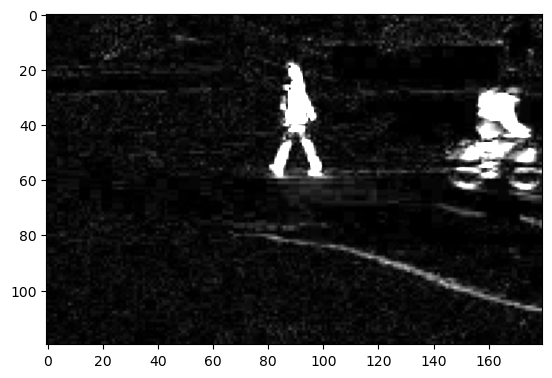

In [15]:
plt.rcParams["animation.html"] = "jshtml"
HTML(plot_images2(np.abs(m2t(E.T, (vid.shape[0], vid.shape[1],400),3)[:,:,200:])).to_jshtml())

In [15]:
def save_video(X, save_name, fps=24):
#     X = normalize8(X)
    X = cv2.normalize(X, None, 255, 0, cv2.NORM_MINMAX, cv2.CV_8U)
    size = X.shape
    if len(size)==3:
        h,w,l = size
    elif len(size)==4:
        h,w,_,l = size
    out = cv2.VideoWriter(save_name+'.avi', cv2.VideoWriter_fourcc(*'H264'), fps, (h,w), False)
    
    if len(size)==3:
        for i in range(l):
            out.write(X[:,:,i])
    elif len(size)==4:
        pass
    out.release()

In [ ]:

lda1 = 0.001
lda2 = 1/np.sqrt(p)
orpca = ORPCA(lda1, lda2, p, rank, verbose=2, projection_maxit=20000, err_tol=1e-8,
               initially_slow_L_update=False, mode='dynamic', forget_factor=0.95)
# orpca.L = L
# orpca.a=1
# orpca.b=0.1
# orpca.clip_threshold = 2000

# X_hat, R, E_hat = orpca.run_sequence(Z)
expressed_variance = [np.linalg.norm(U_subspace.T@orpca.L)/np.linalg.norm(orpca.L)]
rec_err = []
print(f"t-{orpca.sample_count}: Expressed variance: {expressed_variance[-1]}")
for i in range(1000):
    x, r, e = orpca.run_sample(Z[:,i])
    expressed_variance.append(np.linalg.norm(U_subspace.T@orpca.L)/np.linalg.norm(orpca.L))
    rec_err.append(np.linalg.norm(X[:,i]-x)/np.linalg.norm(X[:,i]))
    print(f"t-{orpca.sample_count}: Expressed variance: {expressed_variance[-1]}, rec. err.= {rec_err[-1]}")
    

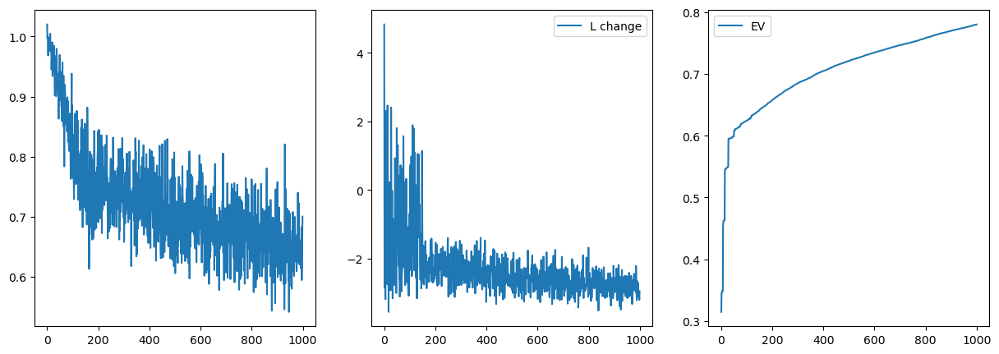

In [10]:
# X_err = X-X_hat
# E_err = E-E_hat
fig,axes = plt.subplots(1,3, figsize=(15,5))
axes[0].plot(rec_err)
axes[1].plot(np.log(orpca.L_change), label='L change')
axes[2].plot(expressed_variance, label='EV')
axes[1].legend()
axes[2].legend()
# axes[0].plot(np.linalg.norm(X,axis=0))
# axes[1].plot(np.linalg.norm(E_err[],axis=0, ord=1)/np.linalg.norm(E,axis=0, ord=1))
# np.linalg.norm(X_err,axis=0)[0]